# Data Wrangling: Dallas Traffic Accidents 
<hr>

## Importing Relevant Libraries

In [84]:
import pandas as pd 
import numpy as np
import seaborn as sns
import plotly.express as px
import missingno as msno 
import miceforest as mf

from dython.data_utils import split_hist
from dython.nominal import associations
from dython.nominal import identify_nominal_columns

import gc

import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import style

In [85]:
# Supress warnings
import warnings
warnings.filterwarnings("ignore")

# To Display all columns 
pd.set_option('display.max_columns', None)

# Set style for graphs, dataviz
style.use(['science', 'notebook', 'grid'])

In [86]:
dallas_city = pd.read_csv('../dataset/raw/Dallas_City_Data_2021.csv')
dallas_city.head(3)

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.77463,32.81833,-96.78806,1.915,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,NaN,US-75 S,R,Dallas,Dallas,TX,75205,US,US/Central,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.63736,32.84640,-96.63711,0.021,At La Prada Dr/Exit 9 - Accident.,NaN,I-635 S,R,Dallas,Dallas,TX,75228,US,US/Central,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.70278,32.79498,-96.69424,0.502,At Jim Miller Rd/Exit 51 - Accident.,NaN,R L Thornton Fwy E,R,Dallas,Dallas,TX,75228,US,US/Central,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [87]:
# Checking the Data Types of each columns
dallas_city.dtypes.value_counts()

object     20
float64    13
bool       13
int64       1
dtype: int64

In [88]:
# Closer look at the names of the columns or attributes
dallas_city.columns

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [89]:
dallas_city.shape

(41615, 47)

In [90]:
# Distribution of the Data
dallas_city.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,41615.000000,41615.000000,41615.000000,41615.000000,41615.000000,41615.000000,14798.000000,41517.000000,33651.000000,41515.000000,41528.000000,41506.000000,40805.000000,33777.000000
mean,2.168161,32.810865,-96.796576,32.810890,-96.796539,0.519945,5072.287133,67.786858,65.893694,61.806239,29.546073,9.507942,8.955949,0.006056
std,0.423263,0.086094,0.070059,0.085941,0.070672,0.777038,3871.460201,17.011423,19.079469,20.651219,0.316948,2.069479,5.062563,0.049506
min,1.000000,32.620309,-97.072350,32.618569,-97.094565,0.000000,1.000000,1.000000,-12.000000,9.000000,28.720000,0.000000,0.000000,0.000000
25%,2.000000,32.749444,-96.839399,32.750629,-96.838176,0.073000,2200.000000,55.000000,54.000000,46.000000,29.320000,10.000000,6.000000,0.000000
50%,2.000000,32.801460,-96.800290,32.801264,-96.801068,0.243000,4031.000000,70.000000,69.000000,62.000000,29.480000,10.000000,8.100000,0.000000
75%,2.000000,32.887905,-96.755401,32.887405,-96.753867,0.672000,7539.750000,81.000000,80.000000,79.000000,29.730000,10.000000,12.000000,0.000000
max,4.000000,33.015130,-96.556901,33.023800,-96.557576,10.622000,39636.000000,105.100000,102.000000,100.000000,30.830000,13.000000,211.000000,2.100000


### Make Column names more self-explanatory

In [91]:
dallas_city.rename(columns={'Number': 'Street_Number', 
                            'Street':'Street_Name', 
                            'Side': 'Street_Side'}, inplace=True)
dallas_city.head(2)

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street_Number,Street_Name,Street_Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.77463,32.81833,-96.78806,1.915,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,NaN,US-75 S,R,Dallas,Dallas,TX,75205,US,US/Central,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.63736,32.84640,-96.63711,0.021,At La Prada Dr/Exit 9 - Accident.,NaN,I-635 S,R,Dallas,Dallas,TX,75228,US,US/Central,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day


### Dropping unnecessary columns

Since we extracted the traffic accident data for Dallas from the US-Accidents, we expect that the following Columns below have values that are shared across all the records in the dataset

In [92]:
dallas_city[['City', 'State', 'Country', 'Timezone']].head(3)

,City,State,Country,Timezone
0,Dallas,TX,US,US/Central
1,Dallas,TX,US,US/Central
2,Dallas,TX,US,US/Central


In [93]:
dallas_city.drop(columns=['City', 'State', 'Country', 'Timezone' ], inplace=True)
dallas_city.head(3)

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street_Number,Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.77463,32.81833,-96.78806,1.915,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,NaN,US-75 S,R,Dallas,75205,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.63736,32.84640,-96.63711,0.021,At La Prada Dr/Exit 9 - Accident.,NaN,I-635 S,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.70278,32.79498,-96.69424,0.502,At Jim Miller Rd/Exit 51 - Accident.,NaN,R L Thornton Fwy E,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [94]:
print(f'The number of columns is reduced to {dallas_city.shape[1]}.')

The number of columns is reduced to 43.


### Note: 

<div class="alert alert-info">
As shown in the previous jupyter notebook in basic exploration of the US-Accidents data and confirmed in the above cell, some columns share the same values all throughout this subset since we extracted Dallas City dataset.
</div>    
<hr>

## Checking Missing Values in Dallas City subset <hr>

In [95]:
na_count = dallas_city.isna().sum() # total count of missing values per column or feature

In [96]:
missing_val = na_count.reset_index()
missing_val.rename(columns={'index':'Field', 0:'Count'}, inplace=True)

missing_val['Percentage'] = round((missing_val['Count']/len(dallas_city))*100, 2) #calculating its percentage
missing_val.sort_values(by='Percentage', ascending=False, inplace=True)
missing_val[missing_val['Percentage']>0]

,Field,Count,Percentage
10,Street_Number,26817,64.44
18,Wind_Chill(F),7964,19.14
24,Precipitation(in),7838,18.83
23,Wind_Speed(mph),810,1.95
22,Wind_Direction,189,0.45
25,Weather_Condition,123,0.30
21,Visibility(mi),109,0.26
19,Humidity(%),100,0.24
17,Temperature(F),98,0.24
20,Pressure(in),87,0.21


In [97]:
print("Missing Value Percentage by Field\n")

for _, row in missing_val.iterrows():
    if row['Percentage'] > 0:
        print(f'{row["Field"]}: {row["Percentage"]}%')

Missing Value Percentage by Field

Street_Number: 64.44%
Wind_Chill(F): 19.14%
Precipitation(in): 18.83%
Wind_Speed(mph): 1.95%
Wind_Direction: 0.45%
Weather_Condition: 0.3%
Visibility(mi): 0.26%
Humidity(%): 0.24%
Temperature(F): 0.24%
Pressure(in): 0.21%
Weather_Timestamp: 0.15%
Airport_Code: 0.02%


<hr>

## Visualizing Missing Data & Understanding the correlations across missing values

### Bar Chart

<div class="alert alert-info">
    Each column in this bar plot represents the variables within the dataframe. <br>
    The height of the bar indicates the completeness of each columns. <br>
    The number at the top represent the count of non-null values within each columns. 
</div>

<AxesSubplot:>

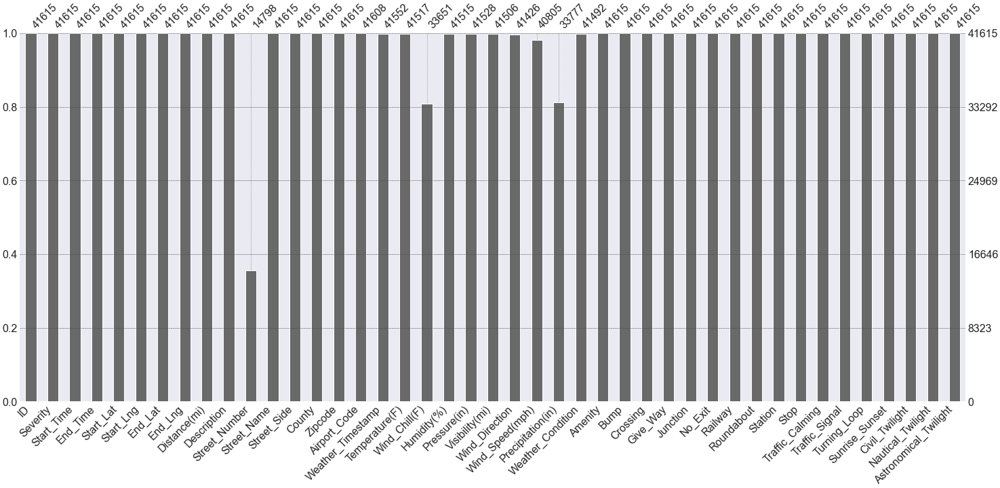

In [98]:
msno.bar(dallas_city)

### Matrix Chart

<div class="alert alert-info">
    Provides color fill for each columns.<br>
    The data present in plot is shaded in grey and white for the missing data.<br>
    Added benefit: displays the distribution of the missing data within the dataset or dataframe.<br>
    Good for timeseries data.
</div>

<AxesSubplot:>

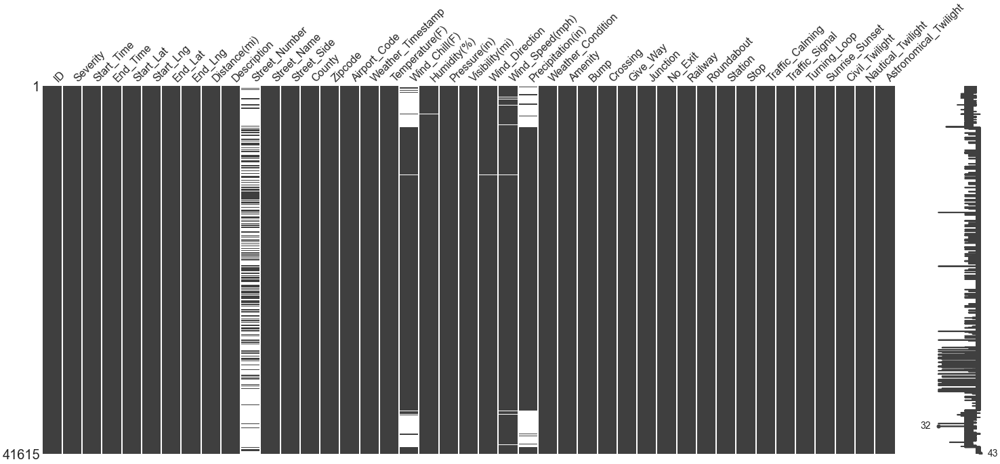

In [99]:
msno.matrix(dallas_city)

### Heat Map / Correlation Matrix for Features with Missing Values

<div class="alert alert-info">
    Identifies the correlation of the nullity between each of the different columns.<br> 
    Checks whether there is a relationship between each columns in the presence of null values between one variable and another. <br><br>
    - Corr greater than 0: positive correlation<br>
    - Corr equal to 0: no correlation<br>
    - Corr less than 0: negative correlation 
</div>

<AxesSubplot:>

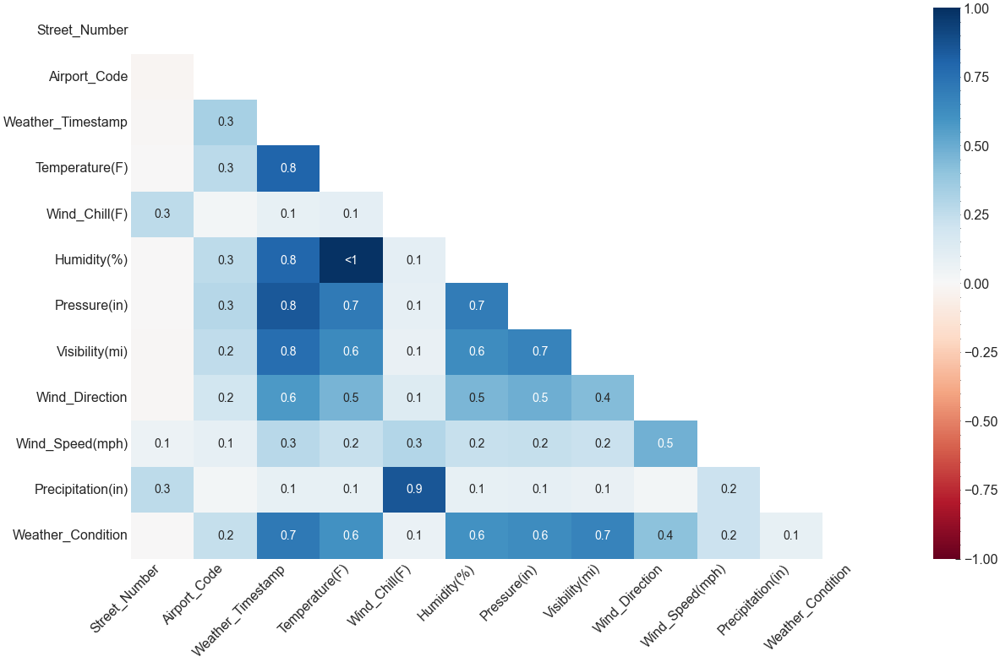

In [100]:
msno.heatmap(dallas_city)

### Dendrogram

<div class="alert alert-info">
    Groups together columns that have strong correlations and nullity.<br>
<div>

<AxesSubplot:>

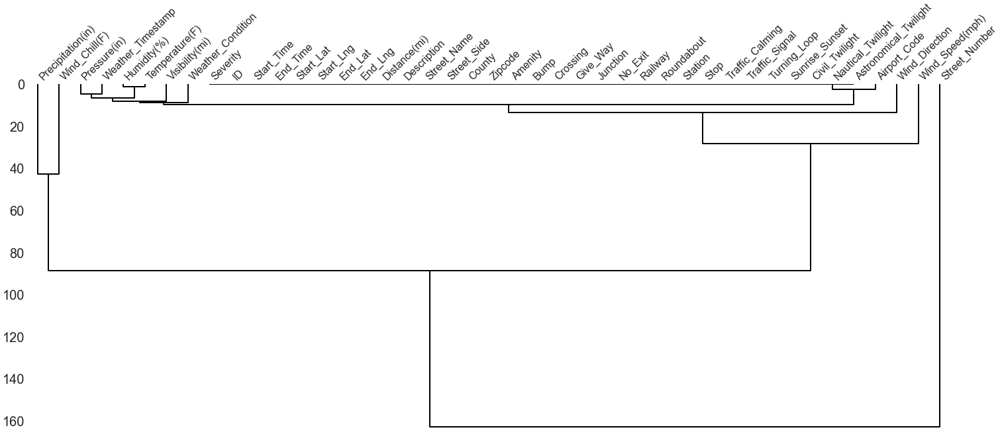

In [101]:
msno.dendrogram(dallas_city)

<div class="alert alert-info">
    Since there is a significant percentage of missing values both in the Precipitation(in) and Wind_Chill(F) variables. We will examine its missingness in order to apply relevant and appropriate missing data handling technique to prevent introducing a bias in the model or your data. 
</div>

<hr>

## Investigating Columns and checking data inconsistencies 


### Checking for duplicates

In [102]:
# Check if there are duplicate entries or records
dallas_city[dallas_city.duplicated()]

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street_Number,Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight


### Street Side

<AxesSubplot:xlabel='Severity', ylabel='count'>

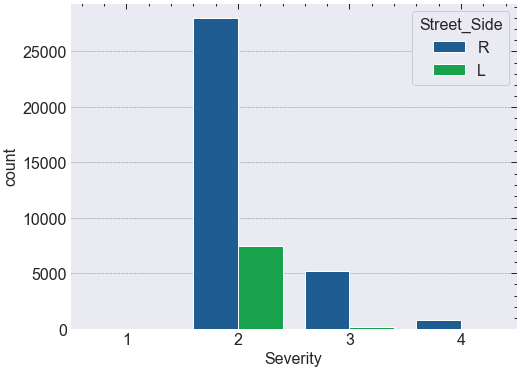

In [103]:
sns.countplot(x='Severity', data=dallas_city, hue='Street_Side')

### County

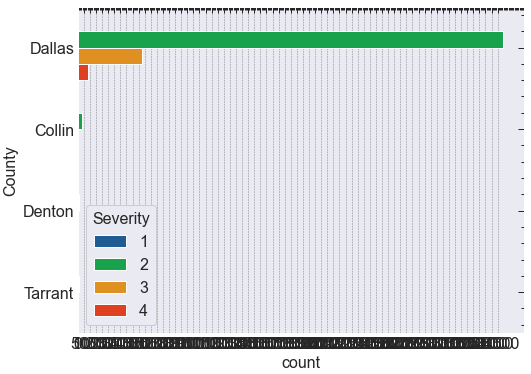

In [104]:
sns.countplot(y='County', data=dallas_city, hue='Severity')
x = np.arange(0, 35000, 500)
plt.xticks(x)

sns.set(rc={"figure.figsize":(30, 7)}) 

In [105]:
dallas_city['County'].unique()

array(['Dallas', 'Collin', 'Denton', 'Tarrant'], dtype=object)

In [106]:
dallas_city.groupby(['Severity', 'County']).count()

ID  Start_Time  End_Time  Start_Lat  Start_Lng  End_Lat  \
Severity County                                                                
1        Dallas       2           2         2          2          2        2   
2        Collin     325         325       325        325        325      325   
         Dallas   34937       34937     34937      34937      34937    34937   
         Denton      76          76        76         76         76       76   
         Tarrant     90          90        90         90         90       90   
3        Collin      51          51        51         51         51       51   
         Dallas    5284        5284      5284       5284       5284     5284   
         Denton       4           4         4          4          4        4   
         Tarrant     31          31        31         31         31       31   
4        Collin       7           7         7          7          7        7   
         Dallas     798         798       798        798        798      798   
         Denton       1           1         1          1          1        1   
         Tarrant      9           9         9          9          9        9   

                  End_Lng  Distance(mi)  Description  Street_Number  \
Severity County                                                       
1        Dallas         2             2            2              0   
2        Collin       325           325          325            165   
         Dallas     34937         34937        34937          14242   
         Denton        76            76           76             58   
         Tarrant       90            90           90              0   
3        Collin        51            51           51              2   
         Dallas      5284          5284         5284            257   
         Denton         4             4            4              0   
         Tarrant       31            31           31              0   
4        Collin         7             7            7              1   
         Dallas       798           798          798             73   
         Denton         1             1            1              0   
         Tarrant        9             9            9              0   

                  Street_Name  Street_Side  Zipcode  Airport_Code  \
Severity County                                                     
1        Dallas             2            2        2             2   
2        Collin           325          325      325           325   
         Dallas         34937        34937    34937         34930   
         Denton            76           76       76            76   
         Tarrant           90           90       90            90   
3        Collin            51           51       51            51   
         Dallas          5284         5284     5284          5284   
         Denton             4            4        4             4   
         Tarrant           31           31       31            31   
4        Collin             7            7        7             7   
         Dallas           798          798      798           798   
         Denton             1            1        1             1   
         Tarrant            9            9        9             9   

                  Weather_Timestamp  Temperature(F)  Wind_Chill(F)  \
Severity County                                                      
1        Dallas                   2               2              2   
2        Collin                 325             323            272   
         Dallas               34876           34858          30559   
         Denton                  76              76             73   
         Tarrant                 90              90             75   
3        Collin                  51              51             20   
         Dallas                5282            5269           2129   
         Denton                   4               4              2   
         Tarrant  

### Wind_Direction <hr>

In [107]:
dallas_city['Wind_Direction'].unique()

array(['NNW', 'North', 'Calm', 'South', 'SSW', 'SSE', 'SE', 'ESE', 'ENE',
       'East', 'NE', 'NNE', 'Variable', 'WSW', 'NW', 'West', 'SW', 'WNW',
       'VAR', 'CALM', 'N', nan, 'S', 'E', 'W'], dtype=object)

In [108]:
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('West','W')
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('Variable','VAR')
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('South','S')
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('Calm','CALM')
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('East','E')
dallas_city['Wind_Direction'] = dallas_city['Wind_Direction'].replace('North','N')

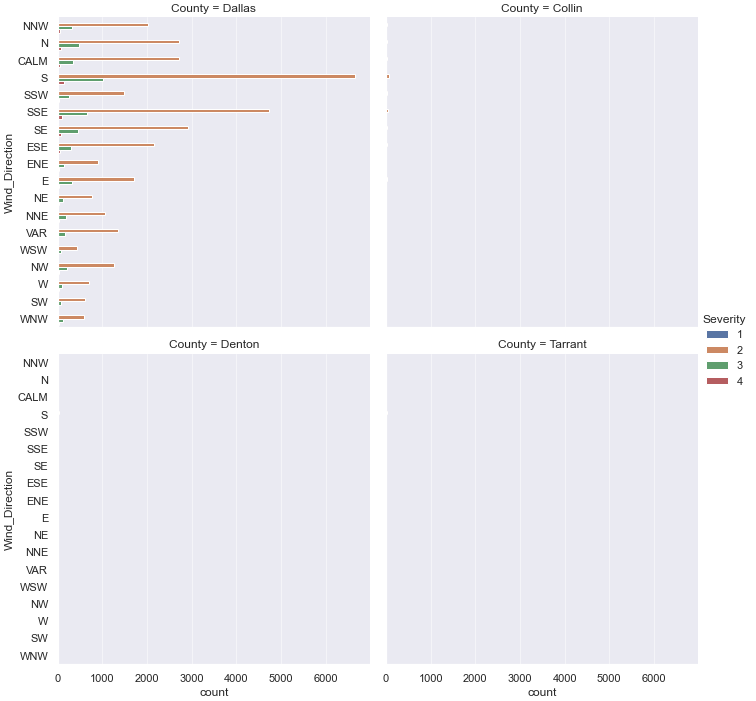

In [109]:
sns.catplot(y="Wind_Direction", hue="Severity", col="County",
...                 col_wrap=2, data=dallas_city, kind="count",
...                 height=5, aspect=1)

## Weather_Condition <hr>

In [110]:
wc_items = dallas_city['Weather_Condition'].unique().astype('str')
wc_items.sort()
wc_items

array(['Blowing Dust', 'Blowing Dust / Windy', 'Clear', 'Cloudy',
       'Cloudy / Windy', 'Drizzle', 'Fair', 'Fair / Windy', 'Fog',
       'Fog / Windy', 'Freezing Rain', 'Haze', 'Heavy Rain',
       'Heavy Rain / Windy', 'Heavy Rain Showers', 'Heavy T-Storm',
       'Heavy T-Storm / Windy', 'Heavy Thunderstorms and Rain',
       'Light Drizzle', 'Light Drizzle / Windy', 'Light Fog',
       'Light Freezing Drizzle', 'Light Freezing Rain', 'Light Rain',
       'Light Rain / Windy', 'Light Rain Showers',
       'Light Rain with Thunder', 'Light Snow', 'Light Snow / Windy',
       'Light Snow and Sleet', 'Light Thunderstorms and Rain', 'Mist',
       'Mostly Cloudy', 'Mostly Cloudy / Windy', 'N/A Precipitation',
       'Overcast', 'Partly Cloudy', 'Partly Cloudy / Windy',
       'Patches of Fog', 'Rain', 'Rain / Windy', 'Rain Showers',
       'Scattered Clouds', 'Showers in the Vicinity', 'Snow',
       'Snow Grains', 'T-Storm', 'T-Storm / Windy', 'Thunder',
       'Thunder / Windy', 'Th

In [111]:
dallas_city['Weather_Condition'].value_counts()

Fair                            14965
Mostly Cloudy                    7017
Cloudy                           5482
Partly Cloudy                    4626
Clear                            2371
Overcast                         1601
Light Rain                       1595
Scattered Clouds                  926
Rain                              449
Fog                               365
Fair / Windy                      297
Light Drizzle                     260
Haze                              226
Heavy Rain                        149
T-Storm                           149
Light Rain with Thunder           126
Mostly Cloudy / Windy              97
Cloudy / Windy                     80
Thunder                            78
Heavy T-Storm                      73
Light Thunderstorms and Rain       60
Partly Cloudy / Windy              59
Light Snow                         55
Drizzle                            50
Blowing Dust                       50
Thunderstorms and Rain             48
Thunderstorm

In [112]:
del wc_items
del x
gc.collect()

15

In [113]:
# Fix Data Inconsistencies by replacing the values

dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Thunder','Thunderstorm')
dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('T-Storm','Thunderstorm')

dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('T-Storm / Windy','Thunderstorm / Windy')
dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Thunder / Windy','Thunderstorm / Windy')

dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Heavy Rain Shower','Heavy Rain')
dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Heavy Rain Showers','Heavy Rain')

dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Light Rain Shower','Light Rain')
dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Light Rain Showers','Light Rain')

dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Rain Shower','Rain')
dallas_city['Weather_Condition'] = dallas_city['Weather_Condition'].replace('Rain Showers','Rain')

In [114]:
dallas_city['Weather_Condition'].unique()

array(['Clear', 'Partly Cloudy', 'Mostly Cloudy', 'Overcast',
       'Light Rain', 'Rain', 'Light Drizzle', 'Drizzle',
       'Scattered Clouds', 'Fog', 'Mist', 'Haze', 'Snow Grains',
       'Light Snow', 'Snow', 'Light Fog', 'Light Thunderstorms and Rain',
       'Heavy Rain', 'Thunderstorm', 'Thunderstorms and Rain',
       'Heavy Thunderstorms and Rain', nan, 'Fair', 'Cloudy',
       'Cloudy / Windy', 'Mostly Cloudy / Windy', 'Partly Cloudy / Windy',
       'Fair / Windy', 'Light Rain with Thunder', 'Thunderstorm / Windy',
       'Heavy T-Storm', 'Light Rain / Windy', 'Heavy T-Storm / Windy',
       'Thunder in the Vicinity', 'Showers in the Vicinity',
       'Light Freezing Drizzle', 'Wintry Mix', 'Blowing Dust',
       'N/A Precipitation', 'Light Snow / Windy', 'Light Freezing Rain',
       'Light Snow and Sleet', 'Freezing Rain', 'Heavy Rain / Windy',
       'Light Drizzle / Windy', 'Patches of Fog', 'Widespread Dust',
       'Blowing Dust / Windy', 'Fog / Windy', 'Rain / Windy']

<hr>

## Visibility

In [115]:
dallas_city['Visibility(mi)'].unique()

array([10.  , 13.  ,  9.  ,  3.  ,  4.  ,  2.5 ,  7.  ,  6.  ,  5.  ,
        8.  ,  2.  ,  0.1 ,  0.2 ,  1.  ,  1.8 , 11.  ,  1.2 ,  1.5 ,
       12.  ,  0.8 ,  0.5 ,   nan,  0.75,  0.25,  0.  ,  5.5 ])

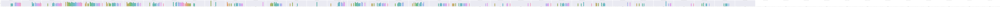

In [116]:
sns.catplot(x="Visibility(mi)", y='Severity', col="Weather_Condition",
...                 data=dallas_city, kind='bar', 
...                 height=5, aspect=2.5)

<hr>

## Wind_Chill(F)

#### Exploring Wind_Chill and Precipitation's Missingness

<div class="alert alert-info">
    Since Wind_Chill and Precipitation has positive correlation. <br>
    Let us confirm it by accessing some of these values.
</div>

In [117]:
dallas_city['Wind_Chill(F)'].describe()

count    33651.000000
mean        65.893694
std         19.079469
min        -12.000000
25%         54.000000
50%         69.000000
75%         80.000000
max        102.000000
Name: Wind_Chill(F), dtype: float64

<hr>

## Precipitation 

Precipitation amount in inches. 

<div class="alert alert-info">
    
 In the United States, precipitation is commonly represented in inches per 24-hour period. <br>This means that if one inch of rain fell in a 24-hour period and, theoretically, water wasn't absorbed by the ground <br>nor did it flow downhill, after the storm there would be a layer of one inch of water covering the ground.
    
    
 Do you know how observers measure precipitation? (2004, August 4). ThoughtCo. https://www.thoughtco.com/measuring-precipitation-1435346
</div>

In [118]:
dallas_city['Precipitation(in)'].describe()

count    33777.000000
mean         0.006056
std          0.049506
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.100000
Name: Precipitation(in), dtype: float64

In [119]:
dallas_city['Precipitation(in)'].value_counts()

0.00    31689
0.01      565
0.02      275
0.03      178
0.04      142
        ...  
1.67        1
2.01        1
0.73        1
0.82        1
2.10        1
Name: Precipitation(in), Length: 80, dtype: int64

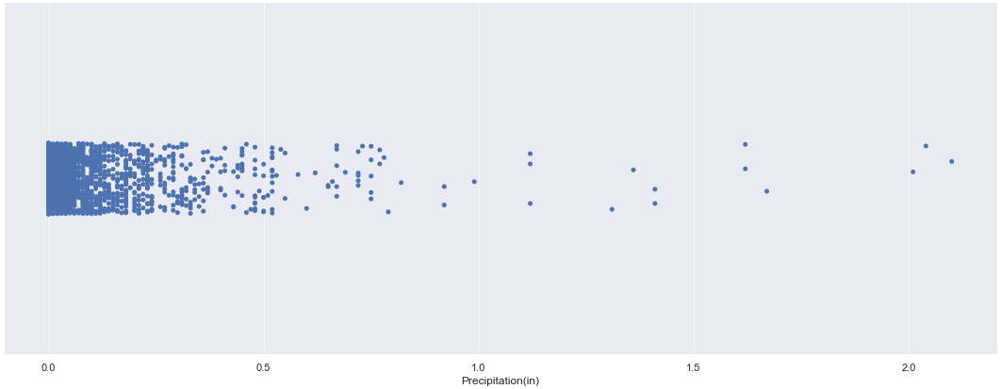

In [120]:
p_graph = sns.catplot(x='Precipitation(in)', data=dallas_city,
...                   height=6, aspect=2.5)

<AxesSubplot:xlabel='Precipitation(in)'>

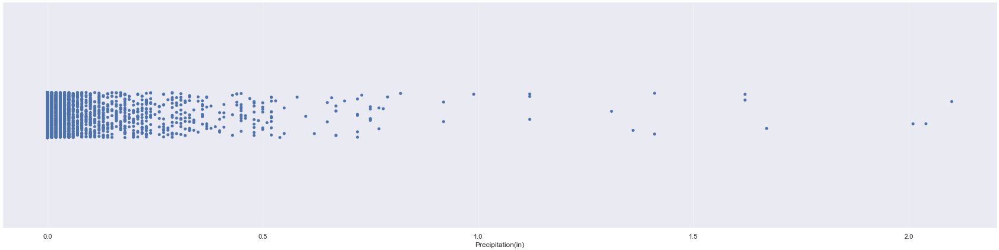

In [121]:
sns.stripplot(x='Precipitation(in)', data=dallas_city,
...         hue='Severity')

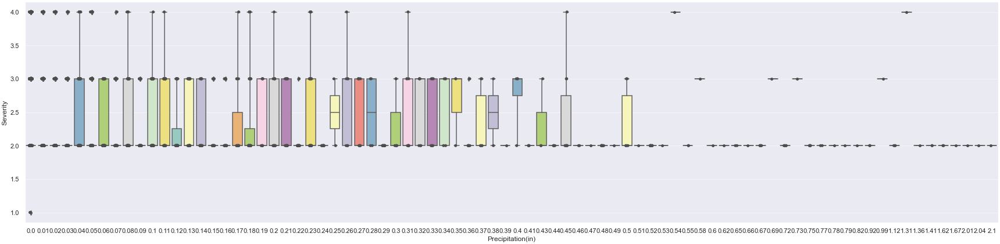

In [122]:
ax = sns.boxplot(x="Precipitation(in)", y='Severity',
...         data=dallas_city, palette="Set3", whis=np.inf)
ax = sns.stripplot(x="Precipitation(in)", y='Severity', data=dallas_city, color=".3")

In [123]:
xtck = np.linspace(0, 1, 10)

fig = px.histogram(dallas_city, x='Precipitation(in)')
fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = xtck
    )
)
fig.show()

In [124]:
fig = px.box(dallas_city, 'Precipitation(in)')
fig.show()

In [125]:
flag = ((dallas_city['Wind_Chill(F)'].isna()==True) & (dallas_city['Precipitation(in)'].isna()==True))

dallas_city[flag][['Wind_Chill(F)', 'Precipitation(in)']].head(5)

,Wind_Chill(F),Precipitation(in)
0,NaN,NaN
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
4,NaN,NaN


In [126]:
dallas_city[flag][['Wind_Chill(F)', 'Precipitation(in)']].shape

(6988, 2)

<hr>

## Distance

In [127]:
fig = px.histogram(dallas_city, x='Distance(mi)')
fig.show()

In [128]:
# Show outliers in terms of boxplot

fig = px.box(dallas_city, x='Distance(mi)')
fig.show()

In [129]:
# Show underlying data

fig = px.box(dallas_city, x='Distance(mi)', points='all')
fig.show()

In [130]:
def find_outliers_IQR(df):

   q1=df.quantile(0.25)
   q3=df.quantile(0.75)
   IQR=q3-q1
   outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]

   return outliers

In [131]:
outliers = find_outliers_IQR(dallas_city['Distance(mi)'])

print("number of outliers:"+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value:"+ str(outliers.min()))

outliers

number of outliers:2937
max outlier value: 10.622
min outlier value:1.571


0        1.915
7        1.720
8        1.915
166      1.813
168      1.915
         ...  
40986    1.636
41022    1.956
41077    2.075
41191    1.797
41399    4.317
Name: Distance(mi), Length: 2937, dtype: float64

In [132]:
# the function to get back a dataframe of all rows instead of just the outliers. 
# If the value is not an outlier, it will display as NaN (not a number):

outliers = find_outliers_IQR(dallas_city[['Precipitation(in)', 'Wind_Chill(F)']])

outliers

,Precipitation(in),Wind_Chill(F)
0,NaN,NaN
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
4,NaN,NaN
...,...,...
41610,NaN,NaN
41611,NaN,NaN
41612,NaN,NaN
41613,NaN,NaN


###  Start_Time & End_Time

Confirm if _'Start_Time'_ and _'End_Time'_ are of valid Datetime type

In [133]:
# If this code returns an error then the Start_Time is not a valid datetime 
# dallas_city.loc[1, 'Start_Time'].day_name()

### Convert to Datetime type

In [134]:
dallas_city['Start_Time'] = pd.to_datetime(dallas_city['Start_Time'])
dallas_city['End_Time'] = pd.to_datetime(dallas_city['End_Time'])

dallas_city.head(5)

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street_Number,Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.77463,32.81833,-96.78806,1.915,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,NaN,US-75 S,R,Dallas,75205,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.63736,32.84640,-96.63711,0.021,At La Prada Dr/Exit 9 - Accident.,NaN,I-635 S,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.70278,32.79498,-96.69424,0.502,At Jim Miller Rd/Exit 51 - Accident.,NaN,R L Thornton Fwy E,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
3,A-11795,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.85710,-96.77046,32.84623,-96.77330,0.769,Between Caruth Haven Ln/Exit 4 and Lovers Ln/E...,NaN,Southwestern Blvd,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,True,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day
4,A-11798,3,2016-11-30 16:21:05,2016-11-30 22:21:05,32.87684,-96.81001,32.88004,-96.80963,0.222,At Walnut Hill Ln - Accident.,NaN,Dallas North Tollway N,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [135]:
type(dallas_city.loc[1, 'Start_Time'])

pandas._libs.tslibs.timestamps.Timestamp

In [136]:
#Calculate the timedelta of the End Time and Start Time
df = (dallas_city['End_Time'] - dallas_city['Start_Time'])
df

0       0 days 06:00:00
1       0 days 06:00:00
2       0 days 06:00:00
3       0 days 06:00:00
4       0 days 06:00:00
              ...      
41610   0 days 00:28:02
41611   0 days 00:28:47
41612   0 days 00:29:29
41613   0 days 00:28:41
41614   0 days 00:27:36
Length: 41615, dtype: timedelta64[ns]

In [137]:
df.describe()

count                        41615
mean     0 days 02:51:05.976667067
std      0 days 19:55:11.459445524
min                0 days 00:06:00
25%                0 days 01:15:00
50%                0 days 01:43:02
75%                0 days 03:22:00
max              167 days 06:52:29
dtype: object

### Converting timedelta to hours

In [138]:
def tdelta_to_hours(timedelta):
    hr, r = divmod(int(timedelta.total_seconds()), 60*60)
    mins, sec = divmod(r, 60)
    hr, mins, sec = (str(x).zfill(2) for x in (hr, mins, sec))
    return f"{hr}:{mins}:{sec}"

dallas_city['Duration'] = df.apply(tdelta_to_hours)
dallas_city

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street_Number,Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Duration
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.774630,32.81833,-96.78806,1.915,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,NaN,US-75 S,R,Dallas,75205,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.637360,32.84640,-96.63711,0.021,At La Prada Dr/Exit 9 - Accident.,NaN,I-635 S,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.702780,32.79498,-96.69424,0.502,At Jim Miller Rd/Exit 51 - Accident.,NaN,R L Thornton Fwy E,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
3,A-11795,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.85710,-96.770460,32.84623,-96.77330,0.769,Between Caruth Haven Ln/Exit 4 and Lovers Ln/E...,NaN,Southwestern Blvd,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,True,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day,06:00:00
4,A-11798,3,2016-11-30 16:21:05,2016-11-30 22:21:05,32.87684,-96.810010,32.88004,-96.80963,0.222,At Walnut Hill Ln - Accident.,NaN,Dallas North Tollway N,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41610,A-2844612,3,2019-08-22 08:59:31,2019-08-22 09:27:33,32.86174,-96.657570,32.86653,-96.66512,0.549,At Northwest Hwy/Exit 11 - Accident.,NaN,I-635 W,R,Dallas,75228,KDAL,2019-08-22 08:53:00,84.0,84.0,61.0,29.46,10.0,S,6.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:02
41611,A-2844627,3,2019-08-22 17:54:40,2019-08-22 18:23:27,32.67827,-96.822740,32.67153,-96.82262,0.466,At Laureland Rd/Exit 420 - Accident. Two lanes...,NaN,US-77 S,R,Dallas,75232,KRBD,2019-08-22 17:53:00,96.0,96.0,36.0,29.09,10.0,S,12.0,0.0,Fair,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:47
41612,A-2844632,3,2019-08-22 23:50:30,2019-08-23 00:19:59,32.92601,-96.820616,32.92601,-96.82072,0.006,At Dallas North Tlwy - Accident.,NaN,LBJ Express,R,Dallas,75240,KADS,2019-08-22 23:55:00,88.0,88.0,48.0,29.21,10.0,SSE,8.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night,00:29:29
41613,A-2845067,3,2019-08-23 14:12:33,2019-08-23 14:41:14,32.90422,-96.769110,32.89449,-96.76926,0.672,At Royal Ln/Exit 7 - Accident. Two lanes blocked.,NaN,US-75 S,R,Dallas,75243,KADS,2019-08-23 13:47:00,91.0,91.0,49.0,29.23,10.0,NE,13.0,0.0,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:41


### Description: Confirm whether there is a uniform parttern we can extract

In [139]:
dallas_city.loc[1:5, 'Description']

1                    At La Prada Dr/Exit 9 - Accident.
2                 At Jim Miller Rd/Exit 51 - Accident.
3    Between Caruth Haven Ln/Exit 4 and Lovers Ln/E...
4                        At Walnut Hill Ln - Accident.
5                  At Valwood Pky/Exit 442 - Accident.
Name: Description, dtype: object

### Note:

<div class="alert alert-info center">
Looking at a subset of the 'Description' series, we notice that it might follow a certain pattern that may or may not include road blockage and traffic condition details.Hence, we will look at this more closely by splitting the entire string object and expand into new columns.
</div>


In [140]:
df = dallas_city['Description'].str.split('.', 1, expand=True)
df

,0,1
0,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,
1,At La Prada Dr/Exit 9 - Accident,
2,At Jim Miller Rd/Exit 51 - Accident,
3,Between Caruth Haven Ln/Exit 4 and Lovers Ln/E...,
4,At Walnut Hill Ln - Accident,
...,...,...
41610,At Northwest Hwy/Exit 11 - Accident,
41611,At Laureland Rd/Exit 420 - Accident,Two lanes blocked.
41612,At Dallas North Tlwy - Accident,
41613,At Royal Ln/Exit 7 - Accident,Two lanes blocked.


In [141]:
df.rename(columns={1:'Impact'}, inplace=True)

In [142]:
df[['Description', 'Status']] = df[0].str.rsplit(' - ', 1, expand=True)
df.drop(columns=[0], inplace=True)
df

,Impact,Description,Status
0,,Between Mockingbird Ln/Exit 3 and Knox St/Hend...,Accident
1,,At La Prada Dr/Exit 9,Accident
2,,At Jim Miller Rd/Exit 51,Accident
3,,Between Caruth Haven Ln/Exit 4 and Lovers Ln/E...,Accident
4,,At Walnut Hill Ln,Accident
...,...,...,...
41610,,At Northwest Hwy/Exit 11,Accident
41611,Two lanes blocked.,At Laureland Rd/Exit 420,Accident
41612,,At Dallas North Tlwy,Accident
41613,Two lanes blocked.,At Royal Ln/Exit 7,Accident


In [143]:
pd.DataFrame(df['Status'].value_counts()).reset_index().rename(columns={'index':'Status', 'Status':'Count'})

,Status,Count
0,Accident,11190
1,Road closed due to accident,464
2,I-35E S,188
3,LBJ Fwy W from Exit 25 (I-635) to I-35E/Exit 2...,112
4,LBJ Fwy W,112
...,...,...
1263,US-67 N from I-45/US-75/Exit 46 (I-30) to Jim ...,1
1264,R L Thornton Fwy N is closed from Laureland Rd...,1
1265,I-35E S from Motor St/Exit 431 (I-35E) to Hi L...,1
1266,LBJ Fwy E from US-67/Exit 464 (I-20) to Housto...,1


In [144]:
pd.DataFrame(df['Impact'].value_counts()).reset_index().rename(columns={'index':'Impact', 'Impact':'Count'})

,Impact,Count
0,,37786
1,Two lanes blocked.,633
2,Right lane blocked.,561
3,Lane blocked.,483
4,Left lane blocked.,459
...,...,...
230,PAUL ST Expect long delays.,1
231,F. Hawn Fwy E - US-175 E from Elam Rd (US-175)...,1
232,F. Hawn Fwy E - US-175 E from TX-12 Loop (US-1...,1
233,TATE Drive with caution.,1


In [145]:
df['Description'].value_counts()

Slow traffic on I-635 W                                                       644
Slow traffic on I-635 E                                                       456
Stationary traffic on I-635 W                                                 421
Stationary traffic on I-635 E                                                 358
Stationary traffic on I-35E N - US-77 N                                       320
                                                                             ... 
Accident from exit [464B] to I-20 W                                             1
Incident on LONGBRANCH LN near GREAT TRINITY FOREST WAY Drive with caution      1
Incident on N CENTRAL SERV NB near MCCOMMAS BLVD Drive with caution             1
Incident on BONNIE VIEW RD near SUNNYVALE ST Drive with caution                 1
Ramp to I-45 Northbound and Main St Westbound and Elm St Westbound              1
Name: Description, Length: 15443, dtype: int64

In [146]:
df['Impact'].value_counts()

                                                                                                   37786
 Two lanes blocked.                                                                                  633
 Right lane blocked.                                                                                 561
 Lane blocked.                                                                                       483
 Left lane blocked.                                                                                  459
                                                                                                   ...  
 PAUL ST Expect long delays.                                                                           1
F. Hawn Fwy E - US-175 E from Elam Rd (US-175) to Prairie Creek Rd (US-175) due to accident.           1
F. Hawn Fwy E - US-175 E from TX-12 Loop (US-175) to Prairie Creek Rd (US-175) due to accident.        1
 TATE Drive with caution.                              

In [147]:
df['Impact'].tail()

41610                       
41611     Two lanes blocked.
41612                       
41613     Two lanes blocked.
41614          Lane blocked.
Name: Impact, dtype: object

In [148]:
# Check total missing values per column
df.isna().sum()

Impact             0
Description        0
Status         24448
dtype: int64

### Note: 

<div class="alert alert-warning">
Although there are important details in the description pertaining to traffic impact, road blockage and type of incident , it is really hard to tell and extract these as it does not follow a particular pattern in contrary to what we assumed. And the specific information available is not consistent.
</div>
    
<hr>

In [149]:
# Drop the Description instead
dallas_city.drop(columns=['Description'], inplace=True)
dallas_city

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Street_Number,Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Duration
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.774630,32.81833,-96.78806,1.915,NaN,US-75 S,R,Dallas,75205,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.637360,32.84640,-96.63711,0.021,NaN,I-635 S,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.702780,32.79498,-96.69424,0.502,NaN,R L Thornton Fwy E,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
3,A-11795,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.85710,-96.770460,32.84623,-96.77330,0.769,NaN,Southwestern Blvd,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,True,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day,06:00:00
4,A-11798,3,2016-11-30 16:21:05,2016-11-30 22:21:05,32.87684,-96.810010,32.88004,-96.80963,0.222,NaN,Dallas North Tollway N,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41610,A-2844612,3,2019-08-22 08:59:31,2019-08-22 09:27:33,32.86174,-96.657570,32.86653,-96.66512,0.549,NaN,I-635 W,R,Dallas,75228,KDAL,2019-08-22 08:53:00,84.0,84.0,61.0,29.46,10.0,S,6.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:02
41611,A-2844627,3,2019-08-22 17:54:40,2019-08-22 18:23:27,32.67827,-96.822740,32.67153,-96.82262,0.466,NaN,US-77 S,R,Dallas,75232,KRBD,2019-08-22 17:53:00,96.0,96.0,36.0,29.09,10.0,S,12.0,0.0,Fair,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:47
41612,A-2844632,3,2019-08-22 23:50:30,2019-08-23 00:19:59,32.92601,-96.820616,32.92601,-96.82072,0.006,NaN,LBJ Express,R,Dallas,75240,KADS,2019-08-22 23:55:00,88.0,88.0,48.0,29.21,10.0,SSE,8.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night,00:29:29
41613,A-2845067,3,2019-08-23 14:12:33,2019-08-23 14:41:14,32.90422,-96.769110,32.89449,-96.76926,0.672,NaN,US-75 S,R,Dallas,75243,KADS,2019-08-23 13:47:00,91.0,91.0,49.0,29.23,10.0,NE,13.0,0.0,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,00:28:41


In [150]:
#Deleting df dataframe
del df
gc.collect()

81102

In [151]:
fig = px.scatter_matrix(dallas_city[['Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)', 'Visibility(mi)', 'Precipitation(in)']])
fig.show()

In [152]:
### Extracting Features with True or False Values

In [153]:
tf_data = dallas_city[['Amenity','Bump', 'Crossing', 'Give_Way', 
                            'Junction', 'No_Exit', 'Railway','Roundabout', 
                            'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal', 
                            'Turning_Loop']]
tf_data

,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop
0,False,False,False,False,True,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,True,False,False,False,False,False,False,False,False
3,False,False,True,False,False,False,False,False,False,False,False,True,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
41610,False,False,False,False,False,False,False,False,False,False,False,False,False
41611,False,False,False,False,True,False,False,False,False,False,False,False,False
41612,False,False,False,False,False,False,False,False,False,False,False,False,False
41613,False,False,False,False,False,False,False,False,False,False,False,False,False


In [154]:
tf_data.apply(pd.Series.value_counts)

,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop
False,41278,41602,37777,41610,36603,41548,41276,41615.0,41526,41494,41602,35260,41615.0
True,337,13,3838,5,5012,67,339,NaN,89,121,13,6355,NaN


In [155]:
for col in tf_data:
    fig = px.histogram(tf_data, col)
    fig.show()

In [156]:
del tf_data
gc.collect()

11128

## Using Advanced Matplotlib API <hr>

In [157]:
# fig, ax = plt.subplots(2, 2, figsize=(20,10))
# ax[0][0].hist(dallas_city.Severity, edgecolor='black', bins=10)
# ax[0][0].set_xlabel('Accident Severity')
# ax[0][0].set_ylabel('Frequency of Accidents')
# ax[0][0].set_title('Frequency vs Severity')
# # ax[0][1].scatter(dallas_city.ID,dallas_city.Severity)
# # ax[0][1].set_xlabel('Accident Severity')
# # ax[0][1].set_ylabel('Frequency of Accidents')
# # ax[0][1].set_title('Frequency vs Severity')
# plt.show()

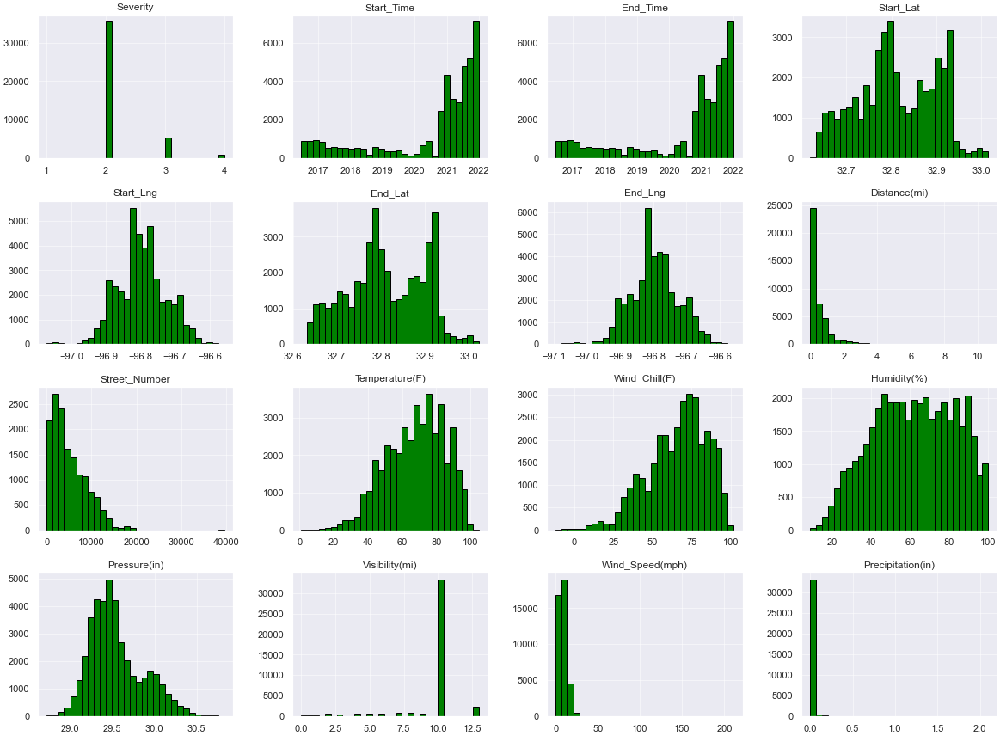

In [158]:
dallas_city.hist(bins=30, figsize=(20,15), color='green', edgecolor='black')
plt.show()

In [159]:
# plt.hist(dallas_city.Severity, bins=[1,2,3,4,5], edgecolor='black', rwidth=0.8, color='blue')
# plt.title("Frequency vs Severity")
# plt.xlabel("Severity")
# plt.ylabel("Frequency of Accidents")
# plt.show()

## Applying Data Imputation Techniques

<hr>

### Dealing with columns or features with missing values
<br>

<div class="alert alert-info">
    
Example of Simple Data Imputation:    
1. Dropping Columns or features<br>
2. Imputing Averages<br>
3. Assigning New Category

Example of Advance Data Imputation:
1. Linear Regression
2. Predictive Mean Matching
3. Stochastic Linear Regression
<div>

<hr>

### Dropping Street Number

<div class="alert alert-info">
    We are dropping the Street_Number column because 65% of its data are missing, which is already the majority of the data at this specific variable. With that, to avoid bias we will drop Street_Number as it is no longer significant.
</div>

In [160]:
dallas_city.drop(columns=['Street_Number'], inplace=True)
dallas_city.head(5)

,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Street_Name,Street_Side,County,Zipcode,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Duration
0,A-11786,2,2016-11-30 15:29:48,2016-11-30 21:29:48,32.84365,-96.77463,32.81833,-96.78806,1.915,US-75 S,R,Dallas,75205,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
1,A-11787,2,2016-11-30 15:41:16,2016-11-30 21:41:16,32.84662,-96.63736,32.84640,-96.63711,0.021,I-635 S,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
2,A-11794,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.79385,-96.70278,32.79498,-96.69424,0.502,R L Thornton Fwy E,R,Dallas,75228,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00
3,A-11795,3,2016-11-30 16:16:05,2016-11-30 22:16:05,32.85710,-96.77046,32.84623,-96.77330,0.769,Southwestern Blvd,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,True,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day,06:00:00
4,A-11798,3,2016-11-30 16:21:05,2016-11-30 22:21:05,32.87684,-96.81001,32.88004,-96.80963,0.222,Dallas North Tollway N,R,Dallas,75225,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day,06:00:00


In [161]:
dallas_city.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41615 entries, 0 to 41614
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ID                     41615 non-null  object        
 1   Severity               41615 non-null  int64         
 2   Start_Time             41615 non-null  datetime64[ns]
 3   End_Time               41615 non-null  datetime64[ns]
 4   Start_Lat              41615 non-null  float64       
 5   Start_Lng              41615 non-null  float64       
 6   End_Lat                41615 non-null  float64       
 7   End_Lng                41615 non-null  float64       
 8   Distance(mi)           41615 non-null  float64       
 9   Street_Name            41615 non-null  object        
 10  Street_Side            41615 non-null  object        
 11  County                 41615 non-null  object        
 12  Zipcode                41615 non-null  object        
 13  A

In [162]:
# Imputing Mode (most frequent) Wind_Chill value in Fahrenheit to fill the missing values

# dallas_city['Wind_Chill(F)'] = dallas_city['Wind_Chill(F)'].fillna(dallas_city['Wind_Chill(F)'].value_counts().index[0])
# dallas_city['Wind_Chill(F)'].value_counts()

<hr>

## Restructure and Reorder DataFrame

In [163]:
dallas_city = dallas_city.reindex(columns = ['Severity', 'Start_Time', 'End_Time', 'Duration', 
                               'Start_Lat', 'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 
                               'Street_Name', 'Street_Side', 'Zipcode', 'County',
                               'Airport_Code','Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
                               'Humidity(%)', 'Pressure(in)','Visibility(mi)', 'Wind_Direction',
                               'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition',
                               'Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
                               'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
                               'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
                               'Astronomical_Twilight'])
dallas_city

,Severity,Start_Time,End_Time,Duration,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Street_Name,Street_Side,Zipcode,County,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,2,2016-11-30 15:29:48,2016-11-30 21:29:48,06:00:00,32.84365,-96.774630,32.81833,-96.78806,1.915,US-75 S,R,75205,Dallas,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,2,2016-11-30 15:41:16,2016-11-30 21:41:16,06:00:00,32.84662,-96.637360,32.84640,-96.63711,0.021,I-635 S,R,75228,Dallas,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,3,2016-11-30 16:16:05,2016-11-30 22:16:05,06:00:00,32.79385,-96.702780,32.79498,-96.69424,0.502,R L Thornton Fwy E,R,75228,Dallas,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
3,3,2016-11-30 16:16:05,2016-11-30 22:16:05,06:00:00,32.85710,-96.770460,32.84623,-96.77330,0.769,Southwestern Blvd,R,75225,Dallas,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,True,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day
4,3,2016-11-30 16:21:05,2016-11-30 22:21:05,06:00:00,32.87684,-96.810010,32.88004,-96.80963,0.222,Dallas North Tollway N,R,75225,Dallas,KDAL,2016-11-30 15:53:00,61.0,NaN,22.0,30.01,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41610,3,2019-08-22 08:59:31,2019-08-22 09:27:33,00:28:02,32.86174,-96.657570,32.86653,-96.66512,0.549,I-635 W,R,75228,Dallas,KDAL,2019-08-22 08:53:00,84.0,84.0,61.0,29.46,10.0,S,6.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
41611,3,2019-08-22 17:54:40,2019-08-22 18:23:27,00:28:47,32.67827,-96.822740,32.67153,-96.82262,0.466,US-77 S,R,75232,Dallas,KRBD,2019-08-22 17:53:00,96.0,96.0,36.0,29.09,10.0,S,12.0,0.0,Fair,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
41612,3,2019-08-22 23:50:30,2019-08-23 00:19:59,00:29:29,32.92601,-96.820616,32.92601,-96.82072,0.006,LBJ Express,R,75240,Dallas,KADS,2019-08-22 23:55:00,88.0,88.0,48.0,29.21,10.0,SSE,8.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
41613,3,2019-08-23 14:12:33,2019-08-23 14:41:14,00:28:41,32.90422,-96.769110,32.89449,-96.76926,0.672,US-75 S,R,75243,Dallas,KADS,2019-08-23 13:47:00,91.0,91.0,49.0,29.23,10.0,NE,13.0,0.0,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [164]:
dallas_city.shape

(41615, 41)

In [165]:
dallas_city.to_csv('../dataset/processed/dallas_cleaned.csv')

## Correlation 

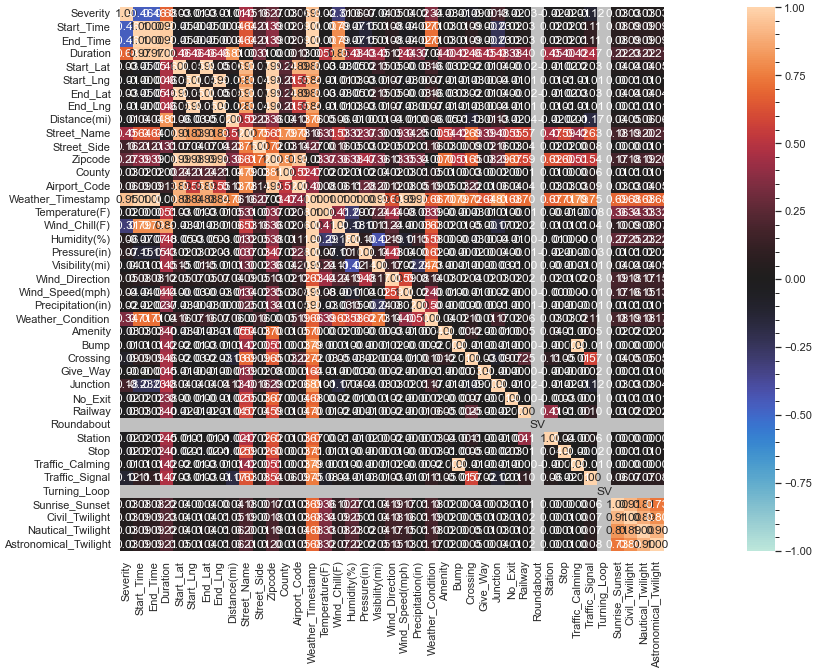

In [166]:
dallas_correlation= associations(dallas_city, filename='full_data_correlation.jpeg', figsize=(30,10))

In [167]:
df_complete_corr=dallas_correlation['corr']
df_complete_corr.dropna(axis=1, how='all').dropna(axis=0, how='all').style.background_gradient(cmap='coolwarm', axis=None).set_precision(2)

,Severity,Start_Time,End_Time,Duration,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Street_Name,Street_Side,Zipcode,County,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
Severity,1.00,-0.46,-0.46,0.68,0.03,-0.01,0.03,-0.01,-0.01,0.45,0.16,0.27,0.03,0.06,0.95,0.02,-0.31,0.06,0.07,-0.04,0.05,0.04,0.02,0.34,-0.03,-0.01,-0.09,-0.00,0.18,-0.02,-0.03,0.00,-0.02,-0.02,-0.01,-0.12,0.00,0.03,0.03,0.03,0.03
Start_Time,-0.46,1.00,1.00,0.97,-0.05,-0.00,-0.05,-0.00,0.04,0.64,0.21,0.39,0.02,0.09,1.00,0.00,0.79,-0.07,-0.15,0.01,0.08,-0.04,-0.02,0.71,0.03,0.01,0.09,-0.00,-0.23,0.02,0.03,0.00,0.02,0.02,0.01,0.11,0.00,0.08,0.09,0.09,0.09
End_Time,-0.46,1.00,1.00,0.97,-0.05,-0.00,-0.05,-0.00,0.04,0.64,0.21,0.39,0.02,0.09,1.00,0.00,0.79,-0.07,-0.15,0.01,0.08,-0.04,-0.02,0.71,0.03,0.01,0.09,-0.00,-0.23,0.02,0.03,0.00,0.02,0.02,0.01,0.11,0.00,0.08,0.09,0.09,0.09
Duration,0.68,0.97,0.97,1.00,0.46,0.46,0.46,0.46,0.81,0.00,0.31,0.00,0.00,0.13,0.00,0.51,0.85,0.48,0.43,0.45,0.12,0.44,0.37,0.04,0.40,0.42,0.46,0.45,0.48,0.38,0.40,0.00,0.45,0.40,0.42,0.47,0.00,0.22,0.23,0.22,0.21
Start_Lat,0.03,-0.05,-0.05,0.46,1.00,0.05,0.99,0.05,0.06,0.91,0.07,0.99,0.24,0.89,0.88,0.03,-0.03,-0.05,0.02,0.15,0.05,0.00,-0.03,0.16,-0.03,0.02,0.02,-0.01,0.04,0.00,-0.02,0.00,-0.01,-0.02,0.02,0.03,0.00,0.04,0.04,0.04,0.05
Start_Lng,-0.01,-0.00,-0.00,0.46,0.05,1.00,0.05,0.99,-0.03,0.83,0.04,0.98,0.21,0.55,0.84,-0.01,-0.01,0.03,0.03,-0.01,0.07,-0.03,-0.00,0.07,-0.01,-0.01,-0.03,-0.00,0.04,-0.01,-0.01,0.00,0.01,0.01,-0.01,-0.01,0.00,0.00,0.01,0.01,0.01
End_Lat,0.03,-0.05,-0.05,0.46,0.99,0.05,1.00,0.05,0.05,0.91,0.07,0.99,0.24,0.89,0.88,0.03,-0.03,-0.05,0.02,0.15,0.05,0.00,-0.03,0.16,-0.03,0.03,0.02,-0.01,0.04,0.00,-0.02,0.00,-0.01,-0.02,0.03,0.03,0.00,0.04,0.04,0.04,0.04
End_Lng,-0.01,-0.00,-0.00,0.46,0.05,0.99,0.05,1.00,-0.02,0.83,0.04,0.96,0.21,0.55,0.84,-0.01,-0.01,0.03,0.03,-0.01,0.07,-0.03,-0.00,0.07,-0.01,-0.01,-0.03,-0.00,0.04,-0.01,-0.01,0.00,0.01,0.01,-0.01,-0.01,0.00,0.00,0.01,0.01,0.01
Distance(mi),-0.01,0.04,0.04,0.81,0.06,-0.03,0.05,-0.02,1.00,0.52,0.23,0.36,0.04,0.13,0.76,0.05,0.06,-0.01,-0.00,0.01,0.04,-0.01,0.00,0.06,-0.05,0.01,-0.13,-0.01,0.13,-0.02,-0.04,0.00,-0.02,-0.02,0.01,-0.17,0.00,0.04,0.05,0.06,0.06
Street_Name,0.45,0.64,0.64,0.00,0.91,0.83,0.91,0.83,0.52,1.00,0.75,0.61,0.79,0.78,0.16,0.31,0.53,0.32,0.37,0.30,0.09,0.34,0.25,0.00,0.54,0.42,0.69,0.39,0.40,0.55,0.57,0.00,0.47,0.59,0.42,0.63,0.00,0.18,0.19,0.20,0.21


In [168]:
categorical_features=identify_nominal_columns(dallas_city)
categorical_features

['Duration',
 'Street_Name',
 'Street_Side',
 'Zipcode',
 'County',
 'Airport_Code',
 'Weather_Timestamp',
 'Wind_Direction',
 'Weather_Condition',
 'Sunrise_Sunset',
 'Civil_Twilight',
 'Nautical_Twilight',
 'Astronomical_Twilight']

In [169]:
selected_column= dallas_city[categorical_features]
categorical_df = selected_column.copy()

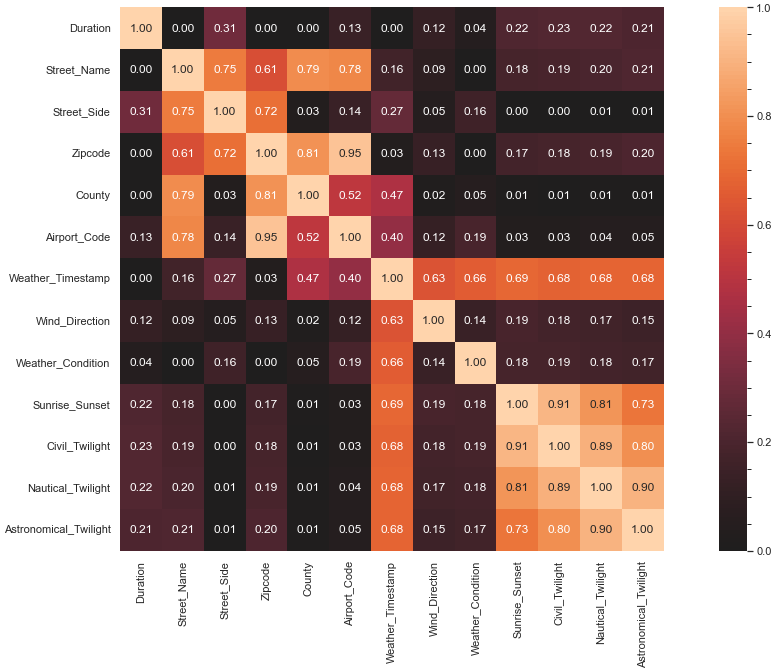

In [170]:
cat_correlation= associations(categorical_df, filename= 'dallas_cat_correlation.jpeg', figsize=(20,10))

## Data Imputation using MICE Algorithm

In [171]:
categorical_data = dallas_city.columns[dallas_city.dtypes == "object"].tolist()
data = dallas_city[categorical_data].apply(pd.Categorical)
dallas_city[categorical_data] = data
dallas_city.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41615 entries, 0 to 41614
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   Severity               41615 non-null  int64         
 1   Start_Time             41615 non-null  datetime64[ns]
 2   End_Time               41615 non-null  datetime64[ns]
 3   Duration               41615 non-null  category      
 4   Start_Lat              41615 non-null  float64       
 5   Start_Lng              41615 non-null  float64       
 6   End_Lat                41615 non-null  float64       
 7   End_Lng                41615 non-null  float64       
 8   Distance(mi)           41615 non-null  float64       
 9   Street_Name            41615 non-null  category      
 10  Street_Side            41615 non-null  category      
 11  Zipcode                41615 non-null  category      
 12  County                 41615 non-null  category      
 13  A

In [172]:
df = dallas_city.drop(columns = ['Start_Time', 'End_Time'])

In [ ]:
import miceforest as mf
kds = mf.ImputationKernel(
    df,
    datasets=5,
    save_all_iterations=True,
    random_state=11
)

kds.mice(5)

In [ ]:
imputed = pd.concat([kds.complete_data(i) for i in range(5)]).groupby(level=0).mean()

In [ ]:
imputed['Precipitation(in)'].isna().sum()